# Illustration for data preparation
The first notebook has shown that in many files the hands and other body parts suddenly disappear. Very often the hand disappears. This is a special probelem pose a problem, as the most important criterion could be the hand.... Therefore this notebook show an attempt to interpolate the different frames to have more meaningul gestures.

In [39]:
import pandas as pd

import os
import numpy as np
import json
from tqdm import tqdm
import matplotlib.pyplot as plt

from matplotlib.animation import FuncAnimation
import matplotlib.animation as animation
import mediapipe as mp
from scipy import interpolate

import sys
sys.path.insert(0, '../src')
from config import *
from IPython.display import HTML


The interpolation is done with scipy and is currently 

In [14]:

def interpolate_frames(frames):
    interp_frames = []
    total_frames = frames.shape[0]
    x_new = np.arange(0,total_frames)
    for col in range(0,frames.shape[1]):
        # print(col)

        idx = frames[:, col] != 0
        if sum(idx) == 0:
            y_new = np.zeros(len(x_new))
        elif sum(idx) == total_frames:
            #Case where there is no coordinate missing
            y_new = frames[:, col]

        else:

            x = np.arange(0, len(frames))[idx]
            y =  frames[:, col][idx]

            f = interpolate.interp1d(x, y,fill_value="extrapolate",kind = "linear")
            #only update missing
            y_new = frames[:, col].copy()
            y_new[~idx] = f(x_new[~idx])
            # y_new = f(x_new)

        interp_frames.append(y_new)

    return (np.array(interp_frames).T).tolist()



In [46]:
def animate_file_interpolated(file_path):

    # sample = torch.load(file_path)
    # print("loaded file", file_path)
    #
    # frames = sample['landmarks']
    # frames_interp = interpolate_frames(np.array(frames))
    # target = sample['target']
    # size = sample['size']
    # landmark_lists = np.array(
    #     [[[frame[i], frame[i + 1]] for i in range(0, len(frame), 2)] for frame in frames[:size]])
    #
    # landmark_lists_ =      np.array(
    #     [[[frame[i], frame[i + 1]] for i in range(0, len(frame), 2)] for frame in frames_interp[:size]])

    sample = torch.load(file_path)
    print("loaded file", file_path)

    frames = sample['landmarks']
    frames_interp = interpolate_frames(np.array(frames).copy())
    target = sample['target']
    size = sample['size']
    landmark_lists = np.array(
        [[[frame[i], frame[i + 1]] for i in range(0, len(frame), 2)] for frame in frames[:size]])
    landmark_lists_interp = np.array(
        [[[frame[i], frame[i + 1]] for i in range(0, len(frame), 2)] for frame in frames_interp[:size]])






    fig, (ax,ax1) = plt.subplots(1,2, figsize=(9, 5),sharex=True,sharey=True)
    # `landmark_lists` is a list containing sequence of mediapipe landmarks for face, left_hand, pose, and right_hand
    face_landmarks = landmark_lists[:, :FACE_FEATURES, :]
    left_hand_landmarks = landmark_lists[:, FACE_FEATURES:FACE_FEATURES + HAND_FEATURES, :]
    pose_landmarks = landmark_lists[:, (FACE_FEATURES + HAND_FEATURES):(FACE_FEATURES + HAND_FEATURES + POSE_FEATURES), :]
    right_hand_landmarks = landmark_lists[:, (FACE_FEATURES + HAND_FEATURES + POSE_FEATURES):, :]

    face_connections = mp.solutions.face_mesh_connections.FACEMESH_CONTOURS
    pose_connections = mp.solutions.pose.POSE_CONNECTIONS
    hand_connections = mp.solutions.hands.HAND_CONNECTIONS


    face_landmarks_inter = landmark_lists_interp[:, :FACE_FEATURES, :]
    left_hand_landmarks_inter = landmark_lists_interp[:, FACE_FEATURES:FACE_FEATURES + HAND_FEATURES, :]
    pose_landmarks_inter = landmark_lists_interp[:, (FACE_FEATURES + HAND_FEATURES):(FACE_FEATURES + HAND_FEATURES + POSE_FEATURES), :]
    right_hand_landmarks_inter = landmark_lists_interp[:, (FACE_FEATURES + HAND_FEATURES + POSE_FEATURES):, :]


    face_connections_0 = mp.solutions.face_mesh_connections.FACEMESH_CONTOURS
    pose_connections_0 = mp.solutions.pose.POSE_CONNECTIONS
    hand_connections_0 = mp.solutions.hands.HAND_CONNECTIONS


    # define a function to update the plot with the new landmarks for each frame
    def update(frame):
        ax.cla()  # clear the plot
        ax1.cla()  # clear the plot
        # plot the landmarks for each body part
        ax.scatter(-pose_landmarks[frame][:, 0], -pose_landmarks[frame][:, 1])
        ax.scatter(-face_landmarks[frame][:, 0], -face_landmarks[frame][:, 1], s=5)
        if -left_hand_landmarks[frame][0, 0] != 0 and -left_hand_landmarks[frame][0, 1] != 0:
            ax.scatter(-left_hand_landmarks[frame][:, 0], -left_hand_landmarks[frame][:, 1], s=10)
        if -right_hand_landmarks[frame][0, 0] != 0 and -right_hand_landmarks[frame][0, 1] != 0:
            ax.scatter(-right_hand_landmarks[frame][:, 0], -right_hand_landmarks[frame][:, 1], s=10)

        for i in pose_connections:
            ax.plot([-pose_landmarks[frame][i[0], 0], -pose_landmarks[frame][i[1], 0]],
                    [-pose_landmarks[frame][i[0], 1], -pose_landmarks[frame][i[1], 1]],
                    color='k', lw=0.8)

        for i in face_connections:
            ax.plot([-face_landmarks[frame][i[0], 0], -face_landmarks[frame][i[1], 0]],
                    [-face_landmarks[frame][i[0], 1], -face_landmarks[frame][i[1], 1]],
                    color='k', lw=0.5)

        if -left_hand_landmarks[frame][0, 0] != 0 and -left_hand_landmarks[frame][0, 1] != 0:
            for i in hand_connections:
                ax.plot([-left_hand_landmarks[frame][i[0], 0], -left_hand_landmarks[frame][i[1], 0]],
                        [-left_hand_landmarks[frame][i[0], 1], -left_hand_landmarks[frame][i[1], 1]],
                        color='k', lw=0.5)

        if -right_hand_landmarks[frame][0, 0] != 0 and -right_hand_landmarks[frame][0, 1] != 0:
            for i in hand_connections:
                ax.plot([-right_hand_landmarks[frame][i[0], 0], -right_hand_landmarks[frame][i[1], 0]],
                        [-right_hand_landmarks[frame][i[0], 1], -right_hand_landmarks[frame][i[1], 1]],
                        color='k', lw=0.5)


        ##Second plot
        ax1.scatter(-pose_landmarks_inter[frame][:, 0], -pose_landmarks_inter[frame][:, 1])
        ax1.scatter(-face_landmarks_inter[frame][:, 0], -face_landmarks_inter[frame][:, 1], s=5)
        if -left_hand_landmarks_inter[frame][0, 0] != 0 and -left_hand_landmarks_inter[frame][0, 1] != 0:
            ax1.scatter(-left_hand_landmarks_inter[frame][:, 0], -left_hand_landmarks_inter[frame][:, 1], s=10)
        if -right_hand_landmarks_inter[frame][0, 0] != 0 and -right_hand_landmarks_inter[frame][0, 1] != 0:
            ax1.scatter(-right_hand_landmarks_inter[frame][:, 0], -right_hand_landmarks_inter[frame][:, 1], s=10)

        for i in pose_connections:
            ax1.plot([-pose_landmarks_inter[frame][i[0], 0], -pose_landmarks_inter[frame][i[1], 0]],
                    [-pose_landmarks_inter[frame][i[0], 1], -pose_landmarks_inter[frame][i[1], 1]],
                    color='k', lw=0.8)

        for i in face_connections:
            ax1.plot([-face_landmarks_inter[frame][i[0], 0], -face_landmarks_inter[frame][i[1], 0]],
                    [-face_landmarks_inter[frame][i[0], 1], -face_landmarks_inter[frame][i[1], 1]],
                    color='k', lw=0.5)

        if -left_hand_landmarks_inter[frame][0, 0] != 0 and -left_hand_landmarks_inter[frame][0, 1] != 0:
            for i in hand_connections:
                ax1.plot([-left_hand_landmarks_inter[frame][i[0], 0], -left_hand_landmarks_inter[frame][i[1], 0]],
                        [-left_hand_landmarks_inter[frame][i[0], 1], -left_hand_landmarks_inter[frame][i[1], 1]],
                        color='k', lw=0.5)

        if -right_hand_landmarks_inter[frame][0, 0] != 0 and -right_hand_landmarks_inter[frame][0, 1] != 0:
            for i in hand_connections:
                ax1.plot([-right_hand_landmarks_inter[frame][i[0], 0], -right_hand_landmarks_inter[frame][i[1], 0]],
                        [-right_hand_landmarks_inter[frame][i[0], 1], -right_hand_landmarks_inter[frame][i[1], 1]],
                        color='k', lw=0.5)


        # ax.axis("equal")
        ax.set_ylim(-1.2, 0)
        ax.set_xlim(-1.5, 0.5)

        ax.set_title(label_dict_inference[target.item()])
        ax1.set_title(label_dict_inference[target.item()] + " Interpolated")
        return


    # create the animation
    ani = FuncAnimation(fig, update, frames=len(pose_landmarks), interval=50)


    return ani


In [27]:
label_dict = json.load(open(os.path.join(ROOT_PATH, RAW_DATA_DIR, MAP_JSON_FILE)))
label_dict_inference = dict(zip(label_dict.values(), label_dict.keys()))

df_train = pd.read_csv(os.path.join(ROOT_PATH, PROCESSED_DATA_DIR, TRAIN_CSV_FILE))

# for _i, row in df_train.iterrows():
#     animate_file_interpolated(os.path.join(ROOT_PATH,PROCESSED_DATA_DIR,row.path))

In [47]:
from IPython.display import display, HTML

# Puts the scrollbar next to the DataFrame
display(
    HTML(
        "<div style='height: 400px; overflow: auto; width: fit-content'>" +
        df_train.to_html() +
        "</div>"
    )
)

,path,participant_id,sequence_id,sign
0,train_landmark_files/26734-1000035562.pt,26734,1000035562,blow
1,train_landmark_files/28656-1000106739.pt,28656,1000106739,wait
2,train_landmark_files/16069-100015657.pt,16069,100015657,cloud
3,train_landmark_files/25571-1000210073.pt,25571,1000210073,bird
4,train_landmark_files/62590-1000240708.pt,62590,1000240708,owie
5,train_landmark_files/26734-1000241583.pt,26734,1000241583,duck
6,train_landmark_files/26734-1000255522.pt,26734,1000255522,minemy
7,train_landmark_files/32319-1000278229.pt,32319,1000278229,lips
8,train_landmark_files/37055-100035691.pt,37055,100035691,flower
9,train_landmark_files/29302-100039661.pt,29302,100039661,time


In [49]:
idx_file = 1

ani = animate_file_interpolated(os.path.join(ROOT_PATH,PROCESSED_DATA_DIR,df_train.loc[idx_file,"path"]))
plt.close() # update
HTML(ani.to_jshtml())


loaded file ../data/processed/train_landmark_files/28656-1000106739.pt


C:\Users\fs.GUNDP\Anaconda3\envs\CAS_FINAL_PROJECT\lib\site-packages\matplotlib\animation.py:884: UserWarning: Animation was deleted without rendering anything. This is most likely not intended. To prevent deletion, assign the Animation to a variable, e.g. `anim`, that exists until you output the Animation using `plt.show()` or `anim.save()`.
  warnings.warn(


In [54]:
def show_samples(idx):
    ani = animate_file_interpolated(os.path.join(ROOT_PATH,PROCESSED_DATA_DIR,df_train.loc[idx,"path"]))
    plt.close() # update
    HTML(ani.to_jshtml())
    return(ani.to_jshtml())
    # FFwriter = animation.FFMpegWriter(fps=10)
    # ani.save('animation.mp4', writer = FFwriter)
    

As you can see, it does not work very well. We have to connect the wrist and the hand in some way...

In [55]:
HTML(show_samples(5))

loaded file ../data/processed/train_landmark_files/26734-1000241583.pt


In [56]:
HTML(show_samples(15))

loaded file ../data/processed/train_landmark_files/28656-1000862366.pt


In [57]:
HTML(show_samples(25))

loaded file ../data/processed/train_landmark_files/18796-1001373962.pt


In [58]:
HTML(show_samples(40))

loaded file ../data/processed/train_landmark_files/36257-1001899025.pt


In [59]:
HTML(show_samples(50))

loaded file ../data/processed/train_landmark_files/61333-1002052130.pt


In [60]:
HTML(show_samples(70))

loaded file ../data/processed/train_landmark_files/22343-1002776784.pt


In [61]:
HTML(show_samples(90))

loaded file ../data/processed/train_landmark_files/62590-1003498206.pt


In [62]:
HTML(show_samples(110))

loaded file ../data/processed/train_landmark_files/16069-100438640.pt


In [64]:
HTML(show_samples(120))

loaded file ../data/processed/train_landmark_files/29302-100475774.pt


# Connect the hand to the wrist 

In [74]:
df_ = pd.read_parquet(os.path.join(ROOT_PATH,RAW_DATA_DIR,"train_landmark_files","2044","635217.parquet"))
df_0 = df_.loc[df_.frame == 22]
df_0.loc[df_0.landmark_index > POSE_FEATURES]

,frame,row_id,type,landmark_index,x,y,z
34,22,22-face-34,face,34,0.308395,0.379223,0.138792
35,22,22-face-35,face,35,0.318627,0.370620,0.085975
36,22,22-face-36,face,36,0.366430,0.412180,0.009563
37,22,22-face-37,face,37,0.421362,0.448959,-0.041108
38,22,22-face-38,face,38,0.425659,0.459846,-0.036299
...,...,...,...,...,...,...,...
463,22,22-face-463,face,463,0.459142,0.344043,0.010341
464,22,22-face-464,face,464,0.450375,0.347106,0.004313
465,22,22-face-465,face,465,0.444220,0.348875,-0.004451
466,22,22-face-466,face,466,0.529103,0.333875,0.002293


(-1.1118234930559994,
 0.10541491713374854,
 -2.679395657032728,
 -0.13186636939644814)

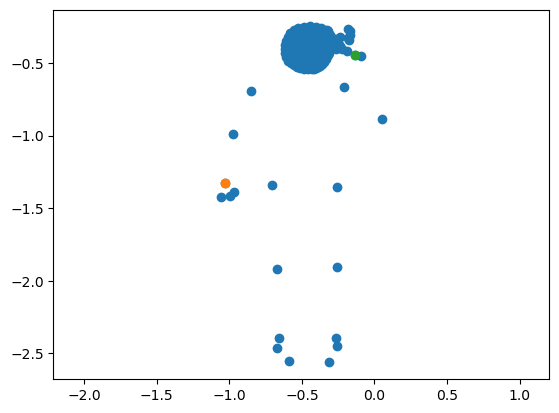

In [94]:
LEFT_WRIST = FACE_FEATURES + HAND_FEATURES+ 15
RIGHT_WRIST = FACE_FEATURES + HAND_FEATURES+ 16
fig,ax = plt.subplots(1)
ax.scatter(-df_0.x,-df_0.y)
ax.scatter(-df_0.iloc[LEFT_WRIST].x,-df_0.iloc[LEFT_WRIST].y)
ax.scatter(-df_0.iloc[RIGHT_WRIST].x,-df_0.iloc[RIGHT_WRIST].y)
ax.axis("equal")

483

In [76]:
display(
    HTML(
        "<div style='height: 400px; overflow: auto; width: fit-content'>" +
        df_0.to_html() +
        "</div>"
    )
)

,frame,row_id,type,landmark_index,x,y,z
0,22,22-face-0,face,0,0.438251,0.449453,-4.782642e-02
1,22,22-face-1,face,1,0.414527,0.404880,-7.199390e-02
2,22,22-face-2,face,2,0.423745,0.420681,-4.214530e-02
3,22,22-face-3,face,3,0.402349,0.372041,-4.390575e-02
4,22,22-face-4,face,4,0.411857,0.393013,-7.474739e-02
5,22,22-face-5,face,5,0.411587,0.379338,-6.694533e-02
6,22,22-face-6,face,6,0.413674,0.347887,-2.378725e-02
7,22,22-face-7,face,7,0.340341,0.361587,5.679097e-02
8,22,22-face-8,face,8,0.411991,0.323421,-9.492436e-03
9,22,22-face-9,face,9,0.409135,0.308535,-8.691768e-03
